# Textractor

* [Textractor Documentation](https://aws-samples.github.io/amazon-textract-textractor/index.html)

> utilities to call Textract services, convert JSON responses from API calls to programmable objects, visualize entities on the document and export document data is compatible formats. It is intended to aid Textract customers in setting up their post-processing pipelines.

* [Textractor Github](https://github.com/aws-samples/amazon-textract-textractor)

In [1]:
import json
import os
import pathlib
from platform import python_version
from typing import (
    List,
    Dict,
)

from PIL import Image

import boto3
import textractor
from textractor import Textractor
from textractor.data.constants import TextractFeatures
from textractor.entities.line import Line
from textractor.entities.value import Value
from textractor.entities.word import Word
from textractor.entities.table import Table
from textractor.entities.table_title import TableTitle
from textractor.entities.table_cell import TableCell
from textractor.entities.key_value import KeyValue
from textractor.visualizers.entitylist import EntityList
from textractor.entities.bbox import BoundingBox
from textractor.entities.page import Page
from textractor.data.text_linearization_config import TextLinearizationConfig

from IPython.core.display import display, HTML

print(textractor.__version__)
print(python_version())

1.7.4
3.10.12


/tmp/ipykernel_335037/245477569.py:28: DeprecationWarning: Importing display from IPython.core.display is deprecated since IPython 7.14, please import from IPython display
  from IPython.core.display import display, HTML


# Data

In [2]:
DATA_DIR=pathlib.Path("../data")
FILEPATH=DATA_DIR.joinpath("form_1005.png")

# Textractor class

* [classtextractor.textractor.Textractor](https://aws-samples.github.io/amazon-textract-textractor/textractor.html#textractor.textractor.Textractor)


In [3]:
extractor = Textractor(profile_name="default")

# Document class

* [classtextractor.entities.document.Document](https://aws-samples.github.io/amazon-textract-textractor/textractor.entities.html#textractor.entities.document.Document)

## TextractFeatures Enumeration

* [classtextractor.data.constants.TextractFeatures](https://aws-samples.github.io/amazon-textract-textractor/textractor.data.constants.html#textractor.data.constants.TextractFeatures)


In [4]:
document = extractor.analyze_document(
    file_source=str(FILEPATH),
    features=[
        TextractFeatures.LAYOUT, 
        TextractFeatures.FORMS, 
        TextractFeatures.TABLES
    ],
    save_image=True,  # To use images property and visualize of the document instance.
)

ValueError: Could not save to JPEG for display

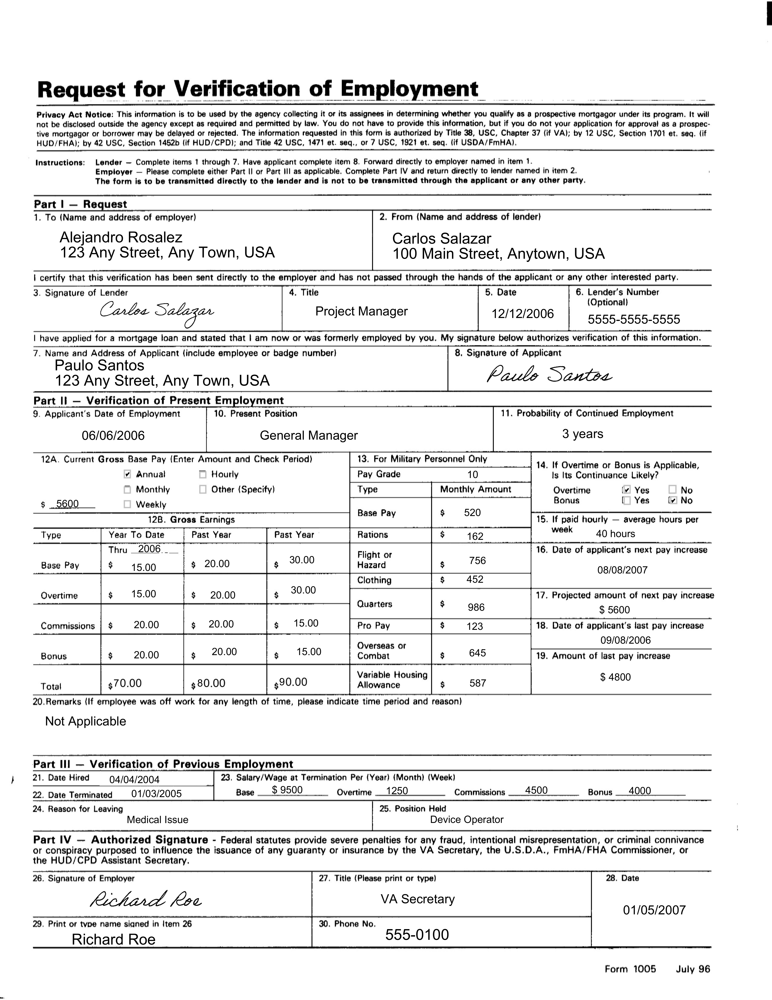

In [5]:
# Original document image
document.images[0]

## API Response

In [6]:
print(json.dumps(document.response, indent=4, default=str))

{
    "DocumentMetadata": {
        "Pages": 1
    },
    "Blocks": [
        {
            "BlockType": "PAGE",
            "Geometry": {
                "BoundingBox": {
                    "Width": 1.0,
                    "Height": 1.0,
                    "Left": 0.0,
                    "Top": 0.0
                },
                "Polygon": [
                    {
                        "X": 0.0,
                        "Y": 0.0
                    },
                    {
                        "X": 1.0,
                        "Y": 2.1393456961504853e-07
                    },
                    {
                        "X": 1.0,
                        "Y": 1.0
                    },
                    {
                        "X": 1.1788772624754529e-08,
                        "Y": 1.0
                    }
                ]
            },
            "Id": "c0336713-fc67-4920-8bc1-bfeb6a2253c5",
            "Relationships": [
                {
                    "T

## Detected Elements

ValueError: Could not save to JPEG for display

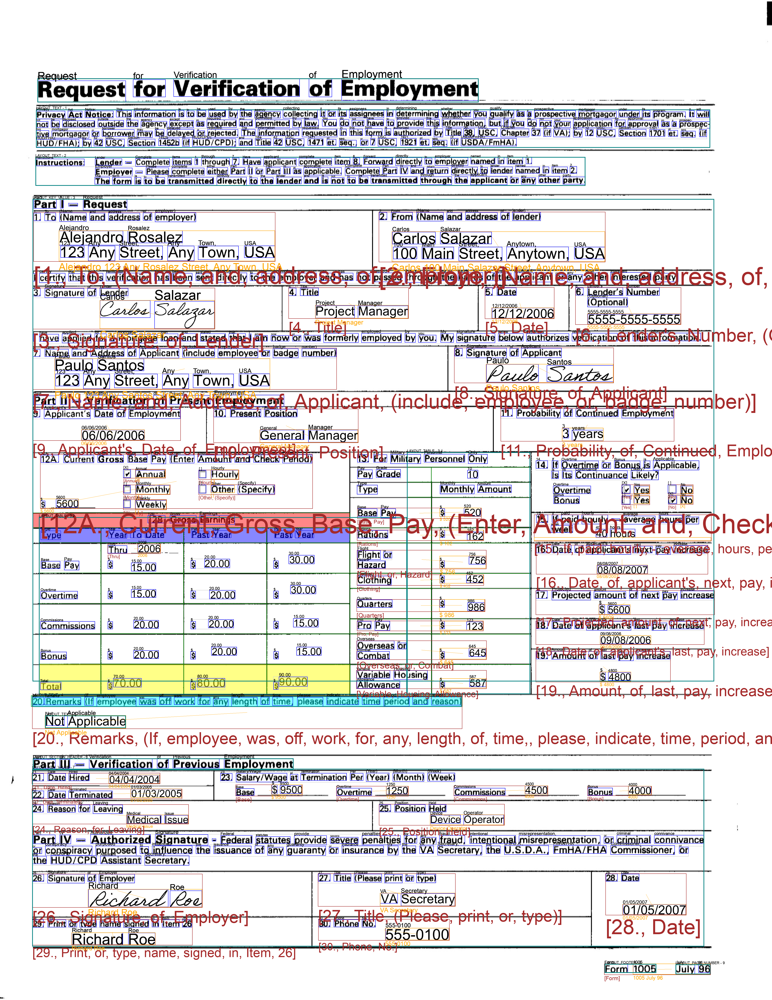

In [7]:
document.visualize()

## Document Properties

In [8]:
print(f"document height:{document.height}, width:{document.width} number of pages:{document.num_pages}")

document height:0, width:0 number of pages:1


### Bounding Box

It is unclear the unit and scale of the coordinate of the bounding boxes.

* [[Doc] BoundingBox coordinate unit and scale are unclear #319](https://github.com/aws-samples/amazon-textract-textractor/issues/319)

* [classtextractor.entities.bbox.BoundingBox(x: float, y: float, width: float, height: float, spatial_object=None)](https://aws-samples.github.io/amazon-textract-textractor/textractor.entities.html?highlight=tabletitle#textractor.entities.bbox.BoundingBox)

> Represents the bounding box of an object in the format of a dataclass with (x, y, width, height). By default BoundingBox is set to work with denormalized co-ordinates: ```x: (0, document-width)```, ```y: (0, document-height)```. Use the ```as_normalized_dict``` function to obtain BoundingBox with normalized co-ordinates: ```x: (0, 1)```, ```y: (0, 1)```

* [Bounding Box](https://docs.aws.amazon.com/textract/latest/dg/text-location.html#bounding-box)

> * Height – The height of the bounding box as a ratio of the overall document page height.
> * Left – The X coordinate of the top-left point of the bounding box as a ratio of the overall document page width.
> * Top – The Y coordinate of the top-left point of the bounding box as a ratio of the overall document page height.
> * Width – The width of the bounding box as a ratio of the overall document page width.
>   
> Each BoundingBox property has a value between 0 and 1. The value is a ratio of the overall image width (applies to Left and Width) or height (applies to Height and Top). For example, if the input image is 700 x 200 pixels, and the top-left coordinate of the bounding box is (350,50) pixels, the API returns a Left value of 0.5 (350/700) and a Top value of 0.25 (50/200).

> <img src="image/textract_bbox.png" align="left" width=300/>

In [20]:
bbox = document.pages[0].words[0].bbox
bbox

AttributeError: 'Page' object has no attribute 'bbox'

In [10]:
print(f"page height:{document.pages[0].height}, document page 0 image height:{document.images[0].height}")

page height:1.0, document page 0 image height:5500


## text

OCR text (left to right order according to 1).

1: [Amazon Textract’s new Layout feature introduces efficiencies in general purpose and generative AI document processing tasks (NOV 2023)](https://aws.amazon.com/blogs/machine-learning/amazon-textracts-new-layout-feature-introduces-efficiencies-in-general-purpose-and-generative-ai-document-processing-tasks/))

In [11]:
print(document.text)

Request for Verification of Employment 

Privacy Act Notice: This information is to be used by the agency collecting it or its assignees in determining whether you qualify as a prospective mortgagor under its program. It will not be disclosed outside the agency except as required and permitted by law. You do not have to provide this information, but if you do not your application for approval as a prospec- tive mortgagor or borrower may be delayed or rejected. The information requested in this form is authorized by Title 38, USC, Chapter 37 (if VA); by 12 USC, Section 1701 et. seq. (if HUD/FHA); by 42 USC, Section 1452b (if HUD/CPD); and Title 42 USC, 1471 et. seq., or 7 USC, 1921 et. seq. (if USDA/FmHA). 

Instructions: Lender - Complete items 1 through 7. Have applicant complete item 8. Forward directly to employer named in item 1. Employer - Please complete either Part II or Part III as applicable. Complete Part IV and return directly to lender named in item 2. The form is to be tra

In [12]:
print(document.get_text())

Request for Verification of Employment 

Privacy Act Notice: This information is to be used by the agency collecting it or its assignees in determining whether you qualify as a prospective mortgagor under its program. It will not be disclosed outside the agency except as required and permitted by law. You do not have to provide this information, but if you do not your application for approval as a prospec- tive mortgagor or borrower may be delayed or rejected. The information requested in this form is authorized by Title 38, USC, Chapter 37 (if VA); by 12 USC, Section 1701 et. seq. (if HUD/FHA); by 42 USC, Section 1452b (if HUD/CPD); and Title 42 USC, 1471 et. seq., or 7 USC, 1921 et. seq. (if USDA/FmHA). 

Instructions: Lender - Complete items 1 through 7. Have applicant complete item 8. Forward directly to employer named in item 1. Employer - Please complete either Part II or Part III as applicable. Complete Part IV and return directly to lender named in item 2. The form is to be tra

## words

In [13]:
print(document.words)

[Verification, of, for, Employment, Request, in, it, its, or, whether, as, a, to, be, used, It, is, the, its, information, under, This, will, Notice:, Act, you, assignees, by, determining, qualify, agency, collecting, prospective, mortgagor, program., Privacy, to, have, this, but, if, not, You, do, and, law., do, not, as, the, for, a, as, outside, information,, disclosed, provide, be, not, you, by, required, permitted, your, application, except, approval, prospec-, agency, is, form, authorized, Title, in, this, 37, The, 12, information, or, be, 1701, borrower, Section, et., or, 38,, USC,, (if, (if, tive, VA);, by, USC,, requested, Chapter, by, delayed, rejected., seq., may, mortgagor, 7, or, 1471, 1921, (if, et., et., 42, Title, and, 1452b, Section, 42, USDA/FmHA)., USC,, USC,, (if, seq., HUD/CPD);, seq.,, USC,, HUD/FHA);, by, -, 1., in, item, named, to, item, Forward, 8., Have, 1, 7., items, Lender, employer, directly, Instructions:, complete, through, applicant, Complete, in, named, 

ValueError: Could not save to JPEG for display

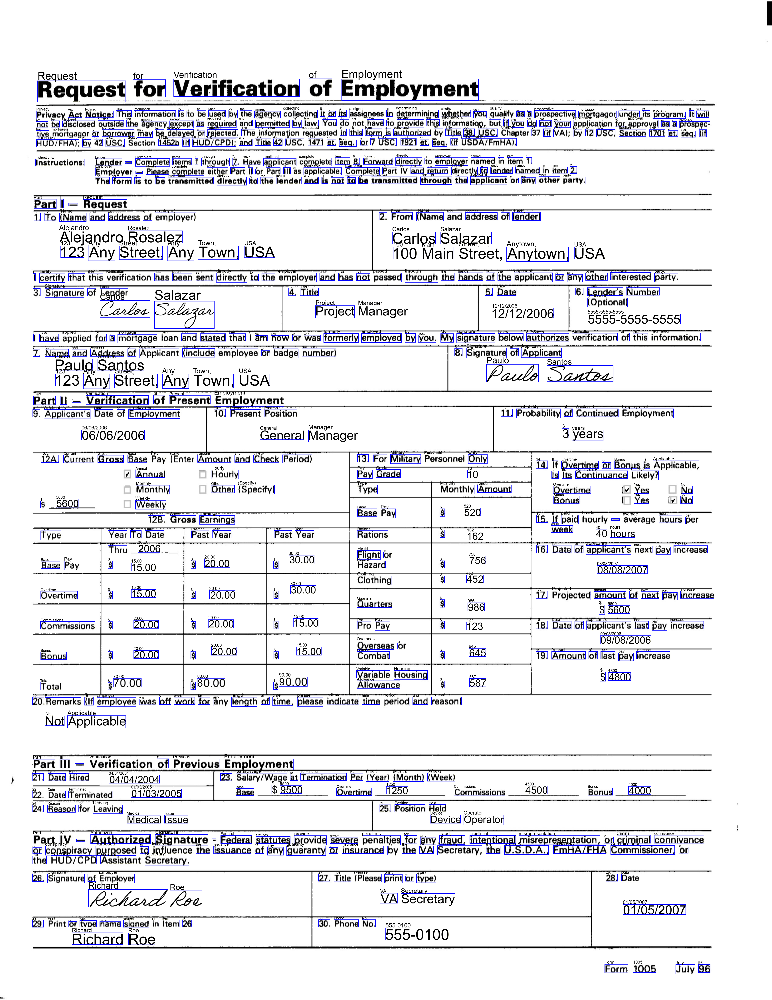

In [14]:
document.words.visualize()

# KeyValue (Form)

```KeyValue``` represents a ```Form``` in the document and [Document](https://aws-samples.github.io/amazon-textract-textractor/textractor.entities.html#module-textractor.entities.document) class ```get``` method or ```key_values``` property returns a list of ```KeyValue``` instances as ```EntityList```.

* [Document](https://aws-samples.github.io/amazon-textract-textractor/textractor.entities.html#module-textractor.entities.document)

> * property [key_values: EntityList\[KeyValue\]](https://aws-samples.github.io/amazon-textract-textractor/textractor.entities.html#textractor.entities.document.Document.key_values)     
> Returns a list of ```KeyValue``` objects, each representing a key-value pair within the Document.
>   
> * [get(key: str, top_k_matches: int = 1, similarity_metric: SimilarityMetric = SimilarityMetric.LEVENSHTEIN, similarity_threshold: float = 0.6)](https://aws-samples.github.io/amazon-textract-textractor/textractor.entities.html#textractor.entities.document.Document.get)  
> Return up to **top_k**_matches of key-value pairs **as an Entity List** [EntityList](https://aws-samples.github.io/amazon-textract-textractor/textractor.visualizers.html#textractor.visualizers.entitylist.EntityList)\[[KeyValue\]](https://aws-samples.github.io/amazon-textract-textractor/textractor.entities.html#textractor.entities.key_value.KeyValue) for the **key** that is queried from the document, sorted from highest to lowest similarity.


## key/vlue class


* [KeyValue](https://aws-samples.github.io/amazon-textract-textractor/textractor.entities.html#module-textractor.entities.key_value)
  
> The ```KeyValue``` entity is a document entity representing the ```Forms``` output. The ```key``` in ```KeyValue``` are typically ```words``` and the ```Value``` could be ```Word``` elements or ```SelectionElement``` in case of checkboxes.
> 
> This class contains the associated metadata with the KeyValue entity including the ```entity ID```, [bounding box](https://aws-samples.github.io/amazon-textract-textractor/textractor.entities.html#module-textractor.entities.bbox) information, ```value```, existence of checkbox, ```page number```, ```Page ID``` and ```confidence``` of detection.
>
> * property ```key: Line```  
> Returns [Line](https://aws-samples.github.io/amazon-textract-textractor/textractor.entities.html#module-textractor.entities.line) object associated with the key.
>
> * property ```value: Value```  
> Returns the [Value](https://aws-samples.github.io/amazon-textract-textractor/textractor.entities.html#textractor.entities.value.Value) mapped to the ```key``` if it has been assigned.

**NOTE**: Defeect as per [The key property of the KeyValue class does not return Line instance](https://github.com/aws-samples/amazon-textract-textractor/issues/317), the ```key``` property of the ```KeyValue``` class is not ```Line``` instance but just a List.

* [classtextractor.entities.key_value.KeyValue(entity_id: str, bbox: BoundingBox, contains_checkbox: bool = False, value: Optional[Value] = None, confidence: float = 0)](https://aws-samples.github.io/amazon-textract-textractor/textractor.entities.html#textractor.entities.key_value.KeyValue)

> * entity_id (str) – Unique identifier of the KeyValue entity.
> * bbox (BoundingBox) – Bounding box of the KeyValue entity.
> * contains_checkbox (bool) – True/False to indicate if the value is a checkbox.
> * value (Value) – Value object that maps to the KeyValue entity.
> * confidence (float) – confidence with which the entity was detected.


**Note** that 
1. ```get``` returns [EntityList](https://aws-samples.github.io/amazon-textract-textractor/textractor.visualizers.html#textractor.visualizers.entitylist.EntityList), **NOT dictionaries**.
2. [key](https://aws-samples.github.io/amazon-textract-textractor/textractor.entities.html#textractor.entities.key_value.KeyValue.key) is [Line](https://aws-samples.github.io/amazon-textract-textractor/textractor.entities.html#textractor.entities.line.Line) instance and [value](https://aws-samples.github.io/amazon-textract-textractor/textractor.entities.html#textractor.entities.key_value.KeyValue.value) is [Value](https://aws-samples.github.io/amazon-textract-textractor/textractor.entities.html#textractor.entities.key_value.KeyValue.value) instance, **NOT string**. 

### Line class (key)

* [classtextractor.entities.line.Line\(entity_id: str, bbox: BoundingBox, words: Optional\[List\[Word\]\] = None, confidence: float = 0\)](https://aws-samples.github.io/amazon-textract-textractor/textractor.entities.html#module-textractor.entities.line)

> Represents a single ```Line``` Entity within the Document. The Textract API response returns groups of words as LINE BlockTypes. They contain Word entities as children. This class contains the associated metadata with the Line entity including the ```entity ID```, [bounding box](https://aws-samples.github.io/amazon-textract-textractor/textractor.entities.html#module-textractor.entities.bbox), child [word](https://aws-samples.github.io/amazon-textract-textractor/textractor.entities.html#module-textractor.entities.word)s, ```page number```, ```Page ID``` and ```confidence``` of detection.
>
> * property ```text: str```
> Returns the text transcription of the ```Line``` entity.
> 
> * property ```words: List[Word]```
> Returns the line’s children as a list of [Word](https://aws-samples.github.io/amazon-textract-textractor/textractor.entities.html#module-textractor.entities.word) instances.


### Value class (value)
* [classtextractor.entities.value.Value\(entity_id: str, bbox: BoundingBox, confidence: float = 0\)](https://aws-samples.github.io/amazon-textract-textractor/textractor.entities.html#textractor.entities.value.Value)

> Represents a single ```Value``` Entity within the Document. The Textract API response returns groups of words as ```KEY_VALUE_SET``` BlockTypes. These may be of ```KEY``` or ```VALUE``` type which is indicated by the ```EntityType``` attribute in the JSON response.
> 
> This class contains the associated metadata with the Value entity including the entity ID, [bounding box](https://aws-samples.github.io/amazon-textract-textractor/textractor.entities.html#module-textractor.entities.bbox), child [word](https://aws-samples.github.io/amazon-textract-textractor/textractor.entities.html#module-textractor.entities.word)s, associated ```key ID```, ```page number```, ```Page ID```, ```confidence``` of detection and if it’s a checkbox.
>
> * property ```words: List[Word]```  
> Returns a list of all words in the entity if it exists else returns the checkbox status of the Value entity.


### Word class

* [class textractor.entities.word.Word\(entity_id: str, bbox: BoundingBox, text: str = '', text_type: TextTypes = TextTypes.PRINTED, confidence: float = 0, is_clickable: bool = False, is_structure: bool = False\)](https://aws-samples.github.io/amazon-textract-textractor/textractor.entities.html#textractor.entities.word.Word)

> Represents a single ```Word``` within the ```Document```. This class contains the associated metadata with the Word entity including the ```text``` transcription, text type, [bounding box](https://aws-samples.github.io/amazon-textract-textractor/textractor.entities.html#module-textractor.entities.bbox) information, ```page number```, ```Page ID``` and ```confidence``` of detection.
>
> * property ```text: str```  
> Returns the text transcription of the Word entity.


### EntityList class

* [EntityList](https://aws-samples.github.io/amazon-textract-textractor/textractor.visualizers.html#textractor.visualizers.entitylist.EntityList)

> The ```EntityList``` is an extension of ```list``` type with custom functions to print document entities in a well formatted manner and visualize on top of the document page with their BoundingBox information.
> 
> The two main functions within this class are ```pretty_print()``` and ```visualize()```. Use ```pretty_print()``` to get a string formatted output of your custom list of entities. Use ```visualize()``` to get the bounding box visualization of the entities on the document page images.



In [19]:
document.key_values

[1. To (Name and address of employer) : Alejandro 123 Any Rosalez Street, Any Town, USA,
 2. From (Name and address of lender) : Carlos 100 Main Salazar Street, Anytown, USA,
 4. Title : Project Manager,
 5. Date : 12/12/2006,
 6. Lender's Number (Optional) : 5555-5555-5555,
 3. Signature of Lender : Carlos Salazar,
 8. Signature of Applicant : Paulo Santos,
 7. Name and Address of Applicant (include employee or badge number) : Paulo 123 Any Santos Street, Any Town, USA,
 9. Applicant's Date of Employment : 06/06/2006,
 11. Probability of Continued Employment : 3 years,
 10. Present Position : General Manager,
 12A. Current Gross Base Pay (Enter Amount and Check Period) : $ 5600,
 Base Pay : $ 520,
 Rations : $ 162,
 15. If paid hourly - average hours per week 40 hours : ,
 Thru : 2006,
 Flight or Hazard : $ 756,
 16. Date of applicant's next pay increase : 08/08/2007,
 Clothing : $ 452,
 Quarters : $ 986,
 17. Projected amount of next pay increase : $ 5600,
 Pro Pay : $ 123,
 18. Date

In [21]:
forms: EntityList[KeyValue] = document.key_values
form: KeyValue = None

print(f'{"page".ljust(4)} {"key".ljust(17, " ")} {"value".ljust(20)}')
print("-" * 100)
for form in forms:
    # https://github.com/aws-samples/amazon-textract-textractor/issues/317
    # key: Line = form.key
    key: List[Word] = form.key
    value: Value = form.value
    
    # print(f"type of value is {type(value)}.")
    # print(f"type of key is {type(key)}.")
    # print(f"type of value is {type(value)}.")

    page: int = form.page
    # key_text: str = key.text
    key_text: str = ' '.join(word.text for word in key)
    value_text = ' '.join([word.text for word in value.words])

    print(f"{page:<3}[{key_text:<15}]:[{value_text}]")

page key               value               
----------------------------------------------------------------------------------------------------
1  [1. To (Name and address of employer)]:[Alejandro 123 Any Rosalez Street, Any Town, USA]
1  [2. From (Name and address of lender)]:[Carlos 100 Main Salazar Street, Anytown, USA]
1  [4. Title       ]:[Project Manager]
1  [5. Date        ]:[12/12/2006]
1  [6. Lender's Number (Optional)]:[5555-5555-5555]
1  [3. Signature of Lender]:[Carlos Salazar]
1  [8. Signature of Applicant]:[Paulo Santos]
1  [7. Name and Address of Applicant (include employee or badge number)]:[Paulo 123 Any Santos Street, Any Town, USA]
1  [9. Applicant's Date of Employment]:[06/06/2006]
1  [11. Probability of Continued Employment]:[3 years]
1  [10. Present Position]:[General Manager]
1  [12A. Current Gross Base Pay (Enter Amount and Check Period)]:[$ 5600]
1  [Base Pay       ]:[$ 520]
1  [Rations        ]:[$ 162]
1  [15. If paid hourly - average hours per week 40 hours]

In [22]:
# NOTE: get method returns EntityList[KeyValue], not a Value.
# It is an extraction from the Document.key_value property.
document.get("Year")

[[1., To, (Name, and, address, of, employer)], [2., From, (Name, and, address, of, lender)], [4., Title], [5., Date], [6., Lender's, Number, (Optional)], [3., Signature, of, Lender], [8., Signature, of, Applicant], [7., Name, and, Address, of, Applicant, (include, employee, or, badge, number)], [9., Applicant's, Date, of, Employment], [11., Probability, of, Continued, Employment], [10., Present, Position], [12A., Current, Gross, Base, Pay, (Enter, Amount, and, Check, Period)], [Base, Pay], [Rations], [15., If, paid, hourly, -, average, hours, per, week, 40, hours], [Thru], [Flight, or, Hazard], [16., Date, of, applicant's, next, pay, increase], [Clothing], [Quarters], [17., Projected, amount, of, next, pay, increase], [Pro, Pay], [18., Date, of, applicant's, last, pay, increase], [Overseas, or, Combat], [19., Amount, of, last, pay, increase], [Variable, Housing, Allowance], [20., Remarks, (If, employee, was, off, work, for, any, length, of, time,, please, indicate, time, period, and, r

[]

In [23]:
document.get("DOB")

[[1., To, (Name, and, address, of, employer)], [2., From, (Name, and, address, of, lender)], [4., Title], [5., Date], [6., Lender's, Number, (Optional)], [3., Signature, of, Lender], [8., Signature, of, Applicant], [7., Name, and, Address, of, Applicant, (include, employee, or, badge, number)], [9., Applicant's, Date, of, Employment], [11., Probability, of, Continued, Employment], [10., Present, Position], [12A., Current, Gross, Base, Pay, (Enter, Amount, and, Check, Period)], [Base, Pay], [Rations], [15., If, paid, hourly, -, average, hours, per, week, 40, hours], [Thru], [Flight, or, Hazard], [16., Date, of, applicant's, next, pay, increase], [Clothing], [Quarters], [17., Projected, amount, of, next, pay, increase], [Pro, Pay], [18., Date, of, applicant's, last, pay, increase], [Overseas, or, Combat], [19., Amount, of, last, pay, increase], [Variable, Housing, Allowance], [20., Remarks, (If, employee, was, off, work, for, any, length, of, time,, please, indicate, time, period, and, r

[]

In [24]:
document.get("POC")

[[1., To, (Name, and, address, of, employer)], [2., From, (Name, and, address, of, lender)], [4., Title], [5., Date], [6., Lender's, Number, (Optional)], [3., Signature, of, Lender], [8., Signature, of, Applicant], [7., Name, and, Address, of, Applicant, (include, employee, or, badge, number)], [9., Applicant's, Date, of, Employment], [11., Probability, of, Continued, Employment], [10., Present, Position], [12A., Current, Gross, Base, Pay, (Enter, Amount, and, Check, Period)], [Base, Pay], [Rations], [15., If, paid, hourly, -, average, hours, per, week, 40, hours], [Thru], [Flight, or, Hazard], [16., Date, of, applicant's, next, pay, increase], [Clothing], [Quarters], [17., Projected, amount, of, next, pay, increase], [Pro, Pay], [18., Date, of, applicant's, last, pay, increase], [Overseas, or, Combat], [19., Amount, of, last, pay, increase], [Variable, Housing, Allowance], [20., Remarks, (If, employee, was, off, work, for, any, length, of, time,, please, indicate, time, period, and, r

[]

In [ ]:
document.get("Martin")

ValueError: Could not save to JPEG for display

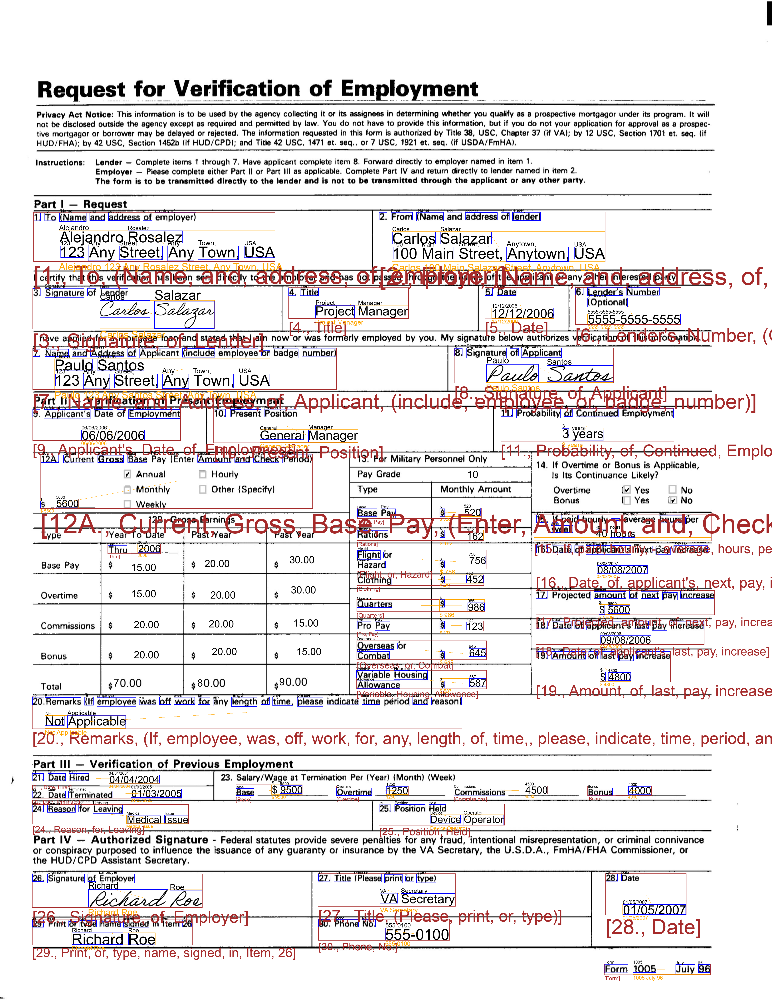

In [25]:
document.key_values.visualize()

## Checkbox

ValueError: Could not save to JPEG for display

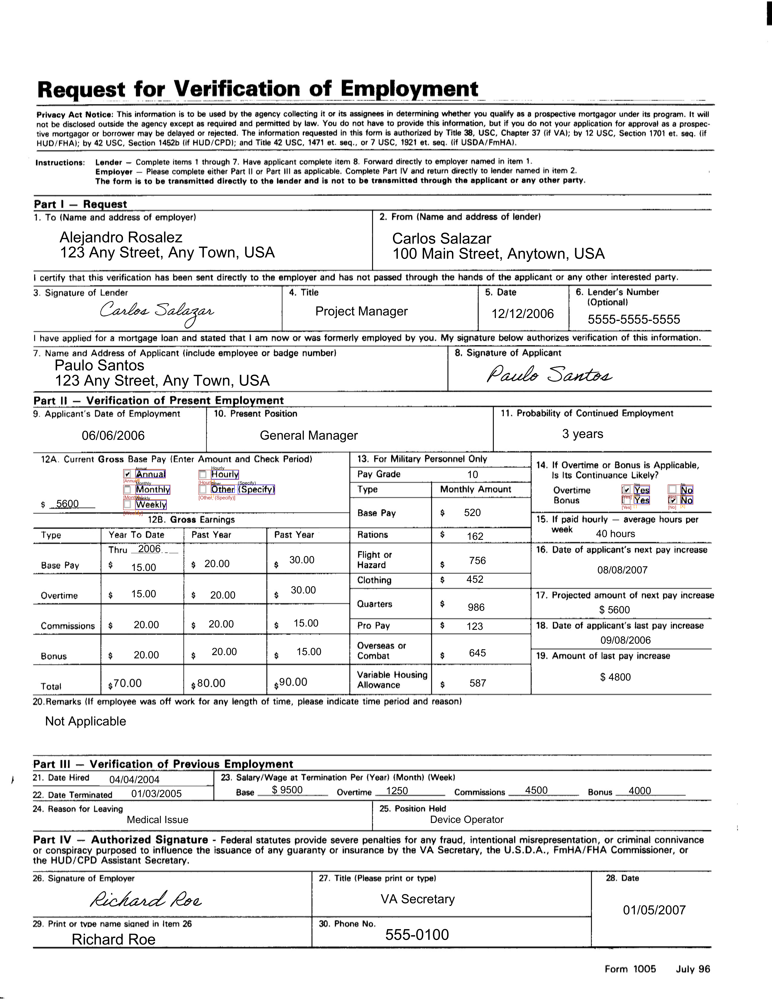

In [26]:
document.checkboxes.visualize()

---
# Regularization

* [TextLinearizationConfig](https://aws-samples.github.io/amazon-textract-textractor/textractor.data.text_linearization_config.html?highlight=textlinearizationconfig)

In [28]:
config = TextLinearizationConfig(
    hide_figure_layout=True,
    hide_footer_layout=True,
    hide_header_layout=True,
    hide_page_num_layout=True,
    hide_table_layout=True,
    layout_element_separator=os.linesep * 2,
    max_number_of_consecutive_new_lines=2,
    max_number_of_consecutive_spaces=1,
    remove_new_lines_in_leaf_elements=True,
    selection_element_selected='[X,/,\]',
)

In [29]:
print(document.get_text(config=config))

Request for Verification of Employment 

Privacy Act Notice: This information is to be used by the agency collecting it or its assignees in determining whether you qualify as a prospective mortgagor under its program. It will not be disclosed outside the agency except as required and permitted by law. You do not have to provide this information, but if you do not your application for approval as a prospec- tive mortgagor or borrower may be delayed or rejected. The information requested in this form is authorized by Title 38, USC, Chapter 37 (if VA); by 12 USC, Section 1701 et. seq. (if HUD/FHA); by 42 USC, Section 1452b (if HUD/CPD); and Title 42 USC, 1471 et. seq., or 7 USC, 1921 et. seq. (if USDA/FmHA). 

Instructions: Lender - Complete items 1 through 7. Have applicant complete item 8. Forward directly to employer named in item 1. Employer - Please complete either Part II or Part III as applicable. Complete Part IV and return directly to lender named in item 2. The form is to be tra

---
# Page

* [Page](https://aws-samples.github.io/amazon-textract-textractor/textractor.entities.html?highlight=layouts#module-textractor.entities.page)

> Represents a single Document page, as it would appear in the Textract API output. The Page object also contains the metadata such as the physical dimensions of the page (width, height, in pixels), child_ids etc.

In [31]:
page: Page = document.pages[0]
# dir(page)

ValueError: Could not save to JPEG for display

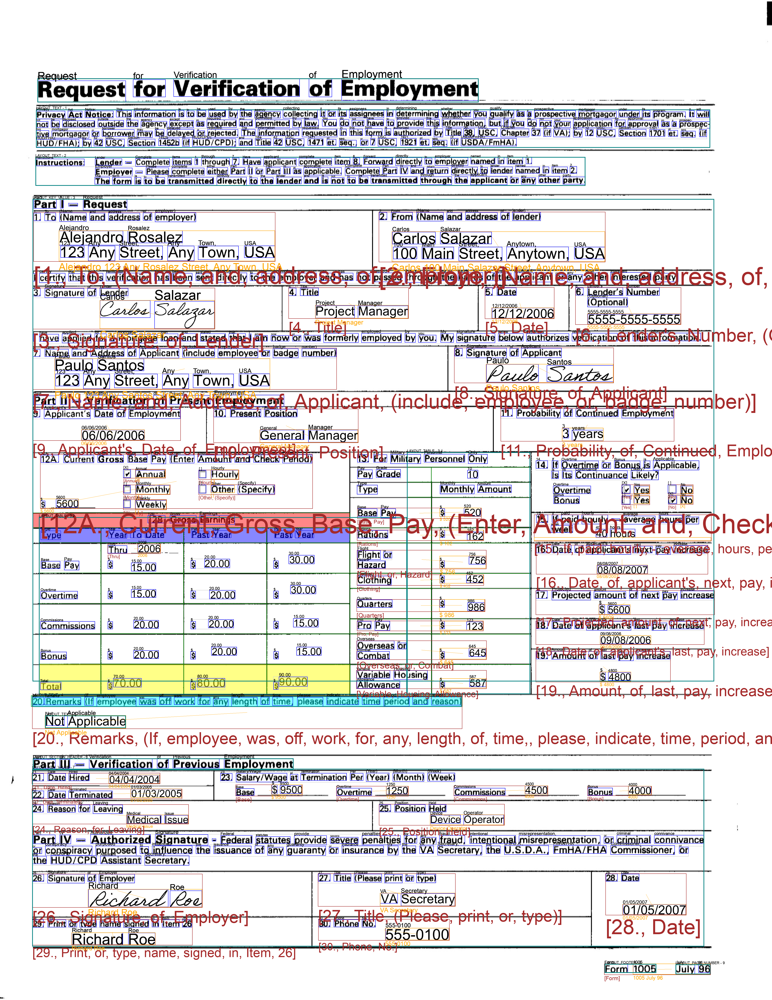

In [32]:
page.visualize()

## Page.layouts

* [property layouts: EntityList\[Layout\]](https://aws-samples.github.io/amazon-textract-textractor/textractor.entities.html?highlight=layouts#textractor.entities.page.Page.layouts)

> Returns all the leaf Layout objects present in the Page.


In [33]:
for layout in page.layouts:
    # print(dir(layout))
    print(f"{layout.layout_type:<25}:[{layout.text}]")

LAYOUT_TITLE             :[Request for Verification of Employment ]
LAYOUT_TEXT              :[Privacy Act Notice: This information is to be used by the agency collecting it or its assignees in determining whether you qualify as a prospective mortgagor under its program. It will not be disclosed outside the agency except as required and permitted by law. You do not have to provide this information, but if you do not your application for approval as a prospec- tive mortgagor or borrower may be delayed or rejected. The information requested in this form is authorized by Title 38, USC, Chapter 37 (if VA); by 12 USC, Section 1701 et. seq. (if HUD/FHA); by 42 USC, Section 1452b (if HUD/CPD); and Title 42 USC, 1471 et. seq., or 7 USC, 1921 et. seq. (if USDA/FmHA). ]
LAYOUT_TEXT              :[Instructions: Lender - Complete items 1 through 7. Have applicant complete item 8. Forward directly to employer named in item 1. Employer - Please complete either Part II or Part III as applicable. Comp

### Layout - Key/Value

In [34]:
key_value_pairs: EntityList[KeyValue] = None
for layout in page.layouts:
    # print(dir(layout))
    if layout.layout_type == "LAYOUT_KEY_VALUE":
        key_value_pairs = layout
        print(f"{layout.layout_type:<25}:[{layout.text}]")
        break

LAYOUT_KEY_VALUE         :[Part I - Request

1. To (Name and address of employer) Alejandro Rosalez 123 Any Street, Any Town, USA 
2. From (Name and address of lender) Carlos Salazar 100 Main Street, Anytown, USA 

I
certify that this verification has been sent directly to the employer and has not passed through the hands of the applicant or any other interested party.

3. Signature of Lender Carlos Salazar 
4. Title Project Manager 
5. Date 12/12/2006 
6. Lender's Number (Optional) 5555-5555-5555 
 I have applied for a mortgage loan and stated that I am now or was formerly employed by you. My signature below authorizes verification of this information.

7. Name and Address of Applicant (include employee or badge number) Paulo Santos 123 Any Street, Any Town, USA 
8. Signature of Applicant Paulo Santos 
 Part II - Verification of Present Employment

9. Applicant's Date of Employment 06/06/2006 
10. Present Position General Manager 
11. Probability of Continued Employment 3 years 

12A.

## Regularization

In [35]:
config = TextLinearizationConfig(
    hide_figure_layout=True,
    hide_footer_layout=True,
    hide_header_layout=True,
    hide_page_num_layout=True,
    hide_table_layout=True,
    layout_element_separator=os.linesep * 2,
    max_number_of_consecutive_new_lines=2,
    max_number_of_consecutive_spaces=1,
    remove_new_lines_in_leaf_elements=True,
    selection_element_selected='[X]',  # <---- If a check box is selected '[X]' is inserted as its text.
)

In [36]:
print(page.get_text(config=config))

Request for Verification of Employment 

Privacy Act Notice: This information is to be used by the agency collecting it or its assignees in determining whether you qualify as a prospective mortgagor under its program. It will not be disclosed outside the agency except as required and permitted by law. You do not have to provide this information, but if you do not your application for approval as a prospec- tive mortgagor or borrower may be delayed or rejected. The information requested in this form is authorized by Title 38, USC, Chapter 37 (if VA); by 12 USC, Section 1701 et. seq. (if HUD/FHA); by 42 USC, Section 1452b (if HUD/CPD); and Title 42 USC, 1471 et. seq., or 7 USC, 1921 et. seq. (if USDA/FmHA). 

Instructions: Lender - Complete items 1 through 7. Have applicant complete item 8. Forward directly to employer named in item 1. Employer - Please complete either Part II or Part III as applicable. Complete Part IV and return directly to lender named in item 2. The form is to be tra

## Page.page_layout

* [property page_layout: PageLayout](https://aws-samples.github.io/amazon-textract-textractor/textractor.entities.html?highlight=layouts#textractor.entities.page.Page.page_layout)

> Returns all the leaf Layout objects present in the Page.
